# ***Compact Finite Difference Schemes*** 

<h6 align = "right">Shantanu Bailoor <br/>
G44942912 </h6>

## ***Introduction***

As seen through the course on numerical methods, discretization of differential equations plays a crucial role in the nature and accuracy of the approximate solution. Discretization schemes in CFD can be broadly classified as:
1. Local Schemes
2. Global Schemes

Local schemes lead to solutions that are globally continuous but only piecewise smooth. The unknown quantity is approximated as a group of polynomials, the degree of which is determined by the programmer. Finite-difference, finite-volume and finite-element methods typically result in local schemes, in which, the solution at a particular grid point is influenced by the solution at a few neighboring points. The number of neighboring points that influence the solution at any point are a measure of the scheme's order of accuracy. Thus, the more the number of grid points in a computational stencil, the greater is the order of accuracy.

On the other hand, global schemes like spectral methods aim at obtaining globally smooth solutions to differential equations. This is achieved by expressing the solution over the entire domain as a single function $u(x)$ using either Fourier transforms [<font color="ff0000">1</font>] or, more commonly, polynomials of the form [<font color="ff0000">2</font>]:

\begin{equation*}u(x) \approx u_{N}(x) = \sum_{n=0}^{N} \hat{u}_{n} \phi_{n}\end{equation*}

where $\phi_{n}$ are basis functions, usually Chebyshev or Legendre polynomials. The value of the derivative of a function, at a point, depends on the values of the function at all nodal points. Spectral methods are inherently very high order methods which scale errors exponentially (spectral resolution). 

Although the spectral methods are capable of producing very accurate results in many cases, they can do so only when the solution is guaranteed to be smooth. Presence of discontinuities, like shocks, cannot be well resolved by such methods. Further, spectral methods are known to not fare too well while describing flows around complex geometries [<font color="ff0000">1</font>]. Local methods provide great flexibility in grid configurations which make them particularly suitable for delineating complex surfaces. Moreover, local schemes do not have any requirements of global smoothness, making them better at resolving strong discontinuities and jump-conditions. These advantages greatly offset their relatively low orders of accuracy, making local schemes very popular in CFD research.

Low-order methods, despite their wide acceptance, suffer substantial shortcomings. One of their major drawbacks is their diffusive nature, which make them particularly unsuitable for flows with significant vortex interaction, turbulent shear layers and strong convection. Of these, vortex-dominated flows are paticularly difficult to model since vortical structures tend to dissipate [<font color="ff0000">3</font>]. Using a low-order method would result in premature diffusion of such vortices. This may be overcome, in part, by using a highly refined grid which, however, would not only make the simulation computationally expensive, but also render it very slow by imposing stringent constraints on permissible time-steps.

Compact finite difference schemes attempt to bridge the gap between the versatile local schemes on the one hand and high-order global schemes on the other. High orders of accuracy (usually $\geq$ 3) can be obtained on small stencils by expressing derivatives of unknown quantities as linear functions of the values of the unknown quantities as well as its derivatives within the stencil. Doing so entails that the spatial derivatives be computed implicitly which lends compact schemes to emulate the global dependance exhibited by spectral methods. A comprehensive exposition of compact schemes, including modified wave number analysis can be found in [<font color="ff0000">4</font>].

In this report, we shall explore Padé schemes, a subset of compact schemes in which the derivative at a point depends on the function values and the derivatives at its adjacent points. For central differenced stencils, Padé schemes result in tridiagonal systems which can be easily inverted to obtain the derivatives in space. In the following sections, we shall see how Padé schemes can be constructed, test a commonly implemented scheme for its higher order of accuracy and compare their performace against traditional finite difference schemes for hyperbolic and parabolic systems. 

## ***Constructing a Padé Scheme***

In this section, we shall take a look at how a Padé scheme can be constructed based on the choice of computational stencil. In esssence, compact schemes mimic the global dependence of function derivatives on function values by expressing the derivatives of a certain order as linear combinations of the function values as well as its derivatives of the same order, at its neighboring points. 

Thus, to construct a central, fourth-order Padé approximation to the first derivative of a smooth fucntion, $f$, using one neighboring point on each side of the solution point, expressions for derivatives can be written as:

\begin{equation*} b_{-1}f^{i}_{j-1} + f^{i}_{j} + b_{1}f^{i}_{j+1} + a_{-1}f_{j-1} + a_{0}f_{j} + a_{1}f_{j+1} = \epsilon \end{equation*}

where $f^{i}_{j}$ represents the first spatial derivative of $f$ evaluated at point with index $j$, $\epsilon$ the approximation error and the coefficients $b_{-1}$, $b_{1}$, $a_{-1}$, $a_{0}$ and $a_{1}$ are arbitrary constants which are determined by writing the Taylor expansions for each of the terms in the expression, as shown below:

\begin{equation*} f^{i}_{j-1} = f^{i}_{j} - \Delta x (f^{ii}_{j}) + \frac{\Delta x^2}{2!} (f^{iii}_{j}) - \frac{\Delta x^3}{3!} (f^{iv}_{j}) + \frac{\Delta x^4}{4!} (f^{v}_{j}) - \frac{\Delta x^5}{5!} (f^{vi}_{j}) + {\mathcal O}(\Delta x^6) \end{equation*}

\begin{equation*} f^{i}_{j+1} = f^{i}_{j} + \Delta x (f^{ii}_{j}) + \frac{\Delta x^2}{2!} (f^{iii}_{j}) + \frac{\Delta x^3}{3!} (f^{iv}_{j}) + \frac{\Delta x^4}{4!} (f^{v}_{j}) + \frac{\Delta x^5}{5!} (f^{vi}_{j}) + {\mathcal O}(\Delta x^6) \end{equation*}

\begin{equation*} f_{j-1} = f_{j} - \Delta x (f^{i}_{j}) + \frac{\Delta x^2}{2!} (f^{ii}_{j}) - \frac{\Delta x^3}{3!} (f^{iii}_{j}) + \frac{\Delta x^4}{4!} (f^{iv}_{j}) - \frac{\Delta x^5}{5!} (f^{v}_{j}) + {\mathcal O}(\Delta x^6) \end{equation*}

\begin{equation*} f_{j+1} = f_{j} + \Delta x (f^{i}_{j}) + \frac{\Delta x^2}{2!} (f^{ii}_{j}) + \frac{\Delta x^3}{3!} (f^{iii}_{j}) + \frac{\Delta x^4}{4!} (f^{iv}_{j}) + \frac{\Delta x^5}{5!} (f^{v}_{j}) + {\mathcal O}(\Delta x^6) \end{equation*}

Here, the superscript Roman numerals indicate the order of the derivative and the subscript $j$ represents the index of the point, about which, the Taylor series is formulated. The above expansions can be used in the linear combination of the function and its derivatives and expressed as a Taylor table, shown below:

  | $f_{j}$ | $f^{i}_{j}$ | $f^{ii}_{j}$ | $f^{iii}_{j}$ | $f^{iv}_{j}$ | $f^{v}_{j}$
 :-:|:-:|:-:|:-:|:-:|:-:|:-:|
 $b_{-1}f^{i}_{j-1}$|$0$|$b_{-1}$|$-b_{-1} \Delta x $|$\frac{\Delta x^2}{2}b_{-1}$ | $\frac{- \Delta x^3}{6}b_{-1} $ | $\frac{\Delta x^4}{24}b_{-1}$
 $f^{i}_{j}$|$0$|$1$|$0$|$0$|$0$|$0$
 $b_{1}f^{i}_{j+1}$|$0$|$b_{1}$|$b_{1} \Delta x $|$\frac{\Delta x^2}{2}b_{1}$ | $\frac{ \Delta x^3}{6}b_{1} $ | $\frac{\Delta x^4}{24}b_{1}$
 $a_{-1}f_{j-1}$|$a_{-1}$|$-a_{-1} \Delta x $|$\frac{\Delta x^2}{2}a_{-1}$ | $\frac{- \Delta x^3}{6}a_{-1} $ | $\frac{\Delta x^4}{24}a_{-1}$| $\frac{- \Delta x^5}{120}a_{-1}$
 $a_{0}f_{j}$|$a_{0}$|$0$|$0$|$0$|$0$|$0$
 $a_{1}f_{j+1}$|$a_{1}$|$a_{1} \Delta x $|$\frac{\Delta x^2}{2}a_{1}$ | $\frac{\Delta x^3}{6}a_{1} $ | $\frac{\Delta x^4}{24}a_{1}$| $\frac{\Delta x^5}{120}a_{1}$

This table represents a system of equations with the coefficients $a_{k}$ and $b_{k}$ as unknown quantities, and may be summarized in the matrix form as:

$$\begin{bmatrix} 
0 & 0 & 1 & 1 & 1\\\\
1 & 1 & -\Delta x & 0 & \Delta x\\\\
 -\Delta x & \Delta x & \frac{\Delta x^2}{2} & 0 & \frac{\Delta x^2}{2}\\\\
 \frac{\Delta x^2}{2} & \frac{\Delta x^2}{2} & -\frac{\Delta x^3}{6} & 0 & \frac{\Delta x^3}{6}\\\\
 -\frac{\Delta x^3}{6} & \frac{\Delta x^3}{6} & \frac{\Delta x^4}{24} & 0 & \frac{\Delta x^4}{24}
\end{bmatrix}
\begin{pmatrix} 
b_{-1} \\\\
 b_{1} \\\\
 a_{-1} \\\\
 a_{0} \\\\
 a_{1}
\end{pmatrix} = 
\begin{pmatrix} 
0 \\\\
 -1 \\\\
 0 \\\\
 0 \\\\
 0
\end{pmatrix}$$

The above system can be solved to obtain values of $a_{k}$ and $b_{k}$ as follows:

$b_{-1} = \frac{1}{4}$, $b_{1} = \frac{1}{4}$, $a_{-1} = \frac{3}{4 \Delta x}$, $a_{0} = 0$ and $a_{1} = \frac{-3}{4 \Delta x}$

Formulated over all non-boundary points, the derivatives at each point can be computed implicitly by solving the following tridiagonal system:

$$\begin{bmatrix} \\\\
 & \ddots & \ddots & \ddots & & &\\\\
 & & \frac{1}{4} & 1 & \frac{1}{4} & &\\\\
 & & & \ddots & \ddots & \ddots \\\\
\\\\
\end{bmatrix}
\begin{pmatrix} 
\vdots \\\\
 f^{i}_{j-1} \\\\
 f^{i}_{j} \\\\
 f^{i}_{j+1} \\\\
\vdots
\end{pmatrix} = 
\begin{pmatrix} 
 \\\\
\vdots \\\\
 \frac{-3}{4 \Delta x}f_{j-1} + \frac{3}{4 \Delta x}f_{j+1} \\\\
\vdots \\\\
 \\\\
\end{pmatrix}$$

Note that while constructing the linear system of equations in the derivatives of $f$, we dropped the column of $f^{v}_{j}$ from the Taylor table, so that the system remains well-constrained. The lowest power of $\Delta x$ contained therein was $4$, indicating that the current centered approximation has a theoretical fourth-order of accuracy.

It is important to remember, however, that inverting the above system requires boundary conditions on the derivatives of $f$ and one must be careful that the approximation applied to the boundary condition is of, at least, the same order as the Padé scheme to avoid contamination of global accuracy. 

## ***Testing Order of Accuracy***

Now let's look at how a five-point, second-order finite difference scheme fares against the corresponding central Padé scheme with the same computational stencil. Consider finding the Laplacian of a smooth function, $u$, in two dimensions such that:

\begin{equation*} u(x,y) = \sin(2 \pi x) \sin(2 \pi y) \end{equation*}

where: \begin{equation*} 0 \leq x, y \leq 1 \end{equation*}

The Laplacian of $u$ can be trivially found  as:

\begin{equation*}\nabla ^2 u = -8 \pi^2 \sin(2 \pi x) \sin(2 \pi y) \end{equation*}

Over the given domain, contour plots of $u$ and its Laplacian look like:

![Contours of u and its Laplacian](./Images/Exact_U_nablaU.png)
<h5 align="center"> _Contour plots of (left) $u$ and (right) $\nabla ^{2} u$._ </h5>

<br />

### <u>_Discretization_</u> 

Both discretization schemes employed herein use a five-point stencil involving the point at which the solution is to be obtained and its four neighbors. The stencil is illustrated in in the following figure. The point highlighted in red is the one where the solution is computed. The green points are the nighbors over which the solution is diffused. Thus, all points enclosed in the blue boxes make the computational stencil.

![Diffusion Stencil](./Images/2D_diffusion_stencil.png)
<h5>_Computational stencil in two dimensions including the current solution point (red) and its four neighbors (green)_</h5>

### <u>_Finite Difference Scheme_</u>

In the traditional finite-difference scheme, a second-order, centered approximation (CDS) to the second derivative of $f$ at point $(i,j)$, with respect to $x$, can be written as:

\begin{equation*}
\left({f_{xx}}\right)_{i,j}= \frac{f_{i+1, j} - 2f_{i,j} + f_{i-1,j}}{\Delta x^2}
\end{equation*}

### <u>_Padé Scheme_</u>

The corresponding Padé scheme is formulated as the following system of equations:

\begin{equation*}
\frac{1}{10}\left({f_{xx}}\right)_{i-1,j} + \left({f_{xx}}\right)_{i,j} + \frac{1}{10}\left({f_{xx}}\right)_{i+1,j} = \frac{12}{10}\left(\frac{f_{i+1, j} - 2f_{i,j} + f_{i-1,j}}{\Delta x^2}\right)
\end{equation*}


Now let's look at a sample code that implements the two discretization schemes and compare their orders of accuracy. 

In [28]:
# Code for finite differencing. 

%matplotlib inline
import numpy
import matplotlib
from matplotlib import pyplot, rcParams, animation

from JSAnimation.IPython_display import display_animation
rcParams['font.family'] = 'serif'
rcParams['font.size'] = 16

In [29]:
#Finite difference code for second derivative
def d2u_FD(u, dh):
    ng = numpy.size(u[1,:]);
    
    dder = numpy.zeros_like(u);
    
    #Evaluate discrete Laplacian
    dder[1:-1,1:-1] = (u[2:,1:-1] + u[:-2,1:-1] + \
                       u[1:-1,2:] + u[1:-1,:-2] - \
                       4*u[1:-1,1:-1])/(dh*dh);
    
    return dder;

In [30]:
# Compact Finite difference code for second derivative
def d2u_CFD(u,dh):
    ng = numpy.size(u[1,:]);
    
    dder = numpy.zeros_like(u);
    ddx  = numpy.zeros_like(u);
    ddy  = numpy.zeros_like(u);
    
    A = numpy.zeros((ng,ng)); 
    bx = numpy.zeros(ng); by = numpy.zeros(ng);
    
    A = numpy.diag(ng * [1]) + numpy.diag((ng-1) * [0.1], 1) + \
        numpy.diag((ng-1) * [0.1], -1);
    A[0,1] = 0; A[-1,-2] = 0;

    #Evaluate d2u/dx2
    for i in range (1, ng-1):
        bx[:] = 1.2/(dh*dh)*(u[i-1,:]-2*u[i,:]+u[i+1,:]);
        Ainv = numpy.linalg.inv(A);
        ddx[i,:] = Ainv.dot(bx);

    #print(A);

    #Evaluate d2u/dy2
    for j in range (1, ng-1):
        by[:] = 1.2/(dh*dh)*(u[:,j-1]-2*u[:,j]+u[:,j+1]);
        Ainv = numpy.linalg.inv(A);
        ddy[:,j] = Ainv.dot(by);

    #print(d2ux);
    dder = ddx + ddy;
    
    return dder;

We defined a function to compute the Laplacian of a quantity, $u$, on a grid with uniform spacing, $dh$. Note that the two derivatives, with respect to $x$ and $y$ are computed individually and added to obtain the Laplacian. In doing so, for each row and column, a linear system is to be solved. In the above code, library functions for inverting the matrix $A$ and computing the dot product of $A^{-1}$ and vector $b$ are used. For very large systems, this may turn out computationally expensive. However, we can use our knowledge of $A$ being a tridiagonal matrix for solving the system of equations more efficiently. Explore the  $\href{https://en.wikipedia.org/wiki/Tridiagonal_matrix_algorithm} {TDMA}$ (TriDiagonal Matrix Algortihm) for computing $A^{-1}b$.

In [31]:
# Main part of code:
ng = 6; nref = 4
Xmin = 0.0; Xmax = 1.0;
Ymin = 0.0; Ymax = 1.0;

dx     = numpy.zeros(nref);
ErrFD  = numpy.zeros(nref);
ErrCFD = numpy.zeros(nref);

for ref in range (nref):
    
    dh = (Xmax-Xmin)/(ng-1);
    dx[ref] = dh

    x = numpy.arange(Xmin, Xmax+dh, dh);
    y = numpy.arange(Ymin, Ymax+dh, dh);

    u = numpy.zeros((ng,ng));
    dduFD  = numpy.zeros_like(u);
    dduCFD = numpy.zeros_like(u);
    d2uex = numpy.zeros_like(u);

    #Define u
    X, Y = numpy.meshgrid(x,y)
    u = numpy.sin(2*numpy.pi*X)*numpy.sin(2*numpy.pi*Y) 

    dduFD = d2u_FD(u,dh);
    dduCFD = d2u_CFD(u,dh);
    
    #Define exact Laplacian
    d2uex = -8*numpy.pi**2*numpy.sin(2*numpy.pi*X)* \
                           numpy.sin(2*numpy.pi*Y);
    
    #Define errors:
    ErrFD[ref] = ErrFD[ref] + numpy.sum(numpy.square(d2uex-dduFD));
    ErrCFD[ref] = ErrCFD[ref] + numpy.sum(numpy.square(d2uex-dduCFD));

    #Define norms:
    ErrFD[ref]  = (ErrFD[ref]/(ng-1)**2)**0.5;
    ErrCFD[ref] = (ErrCFD[ref]/(ng-1)**2)**0.5;
    
    ng = (ng-1)*2 + 1;

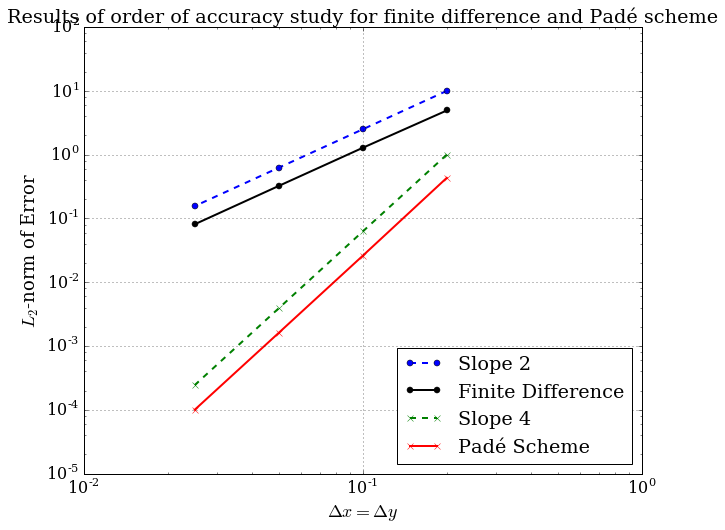

In [32]:
#Define two lines for indicating slopes
slope2 = [10, 2.5, 0.625, 0.15625];
slope4 = [1, 0.0625, 0.00390625, 0.00024414062];

# plot using the matplotlib function loglog()
pyplot.figure(figsize=(10,8))
pyplot.grid(True)
pyplot.xlabel(r'$\Delta x = \Delta y$', fontsize=18)
pyplot.ylabel(r'$L_2$-norm of Error', fontsize=18)
pyplot.title('Results of order of accuracy study for finite difference and Padé scheme');

#Define four plots
pyplot.loglog(dx[:], slope2, color='b', ls='--', lw=2, marker='o', label = 'Slope 2');
pyplot.loglog(dx[:], ErrFD[:], color='k', ls='-', lw=2, marker='o', label = 'Finite Difference');
pyplot.loglog(dx[:], slope4, color='g', ls='--', lw=2, marker='x', label = 'Slope 4');
pyplot.loglog(dx[:], ErrCFD[:], color='r', ls='-', lw=2, marker='x', label = 'Padé Scheme');

#Set limits on axes and define position of legend
pyplot.xlim(1e-2,1);
pyplot.ylim(1e-5,100);
pyplot.legend(loc= 'lower right');

From the above graph we see that the errors using the Padé scheme scaled with the fourth power of grid size, as spoosed to the finite difference scheme where the errors scaled with the second power of size, thus demonstrating their orders of accuracy. 

## ***Applications to differential equations***

### <u>_Parabolic equations_</u>

Parabolic equations describe transient dissipative phenomena, such as heat conduction and Fickian diffusion describing concentration changes of different species in a mixture. The diffusion is described by a Laplacian operator and under, most circumstances, is isotropic. Since there is no preferred direction of flux transfer, central difference schemes work very well for discretizing such equations. 

The following code demonstrates how a fourth-order, central Pade scheme can be implemented for solving a two-dimensional, unsteady diffusion problem, subject to Dirichlet boundary conditions. Consider a square plate of dimensions $1 \times 1$ square units. The bottom and left faces are maintained at a constant temperature $T = 100 K$ while the right and top faces are maintained at $300 K$. The simulation is allowed to run long enough that no significant local changes in temperature occur at the end of the computation i.e. the system reaches steady state. The associated differential equation is:

\begin{equation*} \frac{\partial T}{\partial t } - \alpha\frac{\partial^{2} T}{\partial x^{2} } = 0 \end{equation*}

where $\alpha$ represents the thermal diffusivity (or conductivity) of the conducting material. 

In [33]:
#Define thermal conductivity:
k = 1e-2;

# Define grid parameters
Xmin = 0.0; Xmax = 1.0
Ymin = 0.0; Ymax = 1.0
ng = 21;
mx = ng; my = ng;

dh = (Xmax-Xmin)/(ng-1)
x = numpy.arange(Xmin, Xmax+dh, dh)
y = numpy.arange(Ymin, Ymax+dh, dh)

# Define time parameters
Tmin = 0.0; Tmax = 50.0
dt = 1e-2; time = Tmin
ntime = int((Tmax-Tmin)/dt)

A = numpy.zeros((ng,ng))
b = numpy.zeros(ng)
T = 100.0*numpy.ones((ng, ng))
Tmid = numpy.zeros((int((ntime+1)/100),ng))
Tnew = numpy.zeros_like(T)
ddT = numpy.zeros_like(T);


In [34]:
# Boundary conditions on temperature
T[0,:] = 100; T[-1,:] = 300; 
T[:,0] = 100; T[:,-1] = 300;
count = 0

Tnew = numpy.copy(T)

# Solve the system using fourth-order Compact Finite Difference Scheme
for iter in range (ntime):
    ddT = d2u_CFD(T, dh)
    
    Tnew[1:-1,1:-1] = T[1:-1,1:-1] + k*dt*ddT[1:-1,1:-1]
    
    #Copy new values into old arrays
    T = numpy.copy(Tnew)
    if (numpy.mod(iter,100) == 0):
        Tmid[count][:] = numpy.copy(Tnew[11,:])
        count = count + 1
    
    time = time + dt;

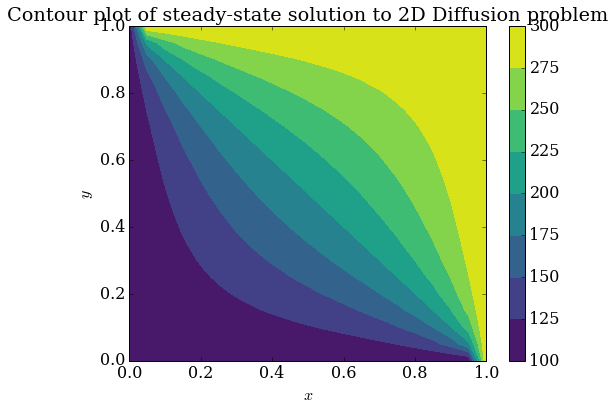

In [35]:
X, Y = numpy.meshgrid(x,y)
pyplot.figure(figsize=(8,6))
pyplot.contourf(X,Y,Tnew,cmap=matplotlib.cm.viridis)
pyplot.xlabel('$x$')
pyplot.ylabel('$y$')
pyplot.title('Contour plot of steady-state solution to 2D Diffusion problem');
pyplot.colorbar();

### <u>_Hyperbolic equations_</u>

Let us now compare how a second-order, upwind Padé scheme fares against the corresponding first-order finite difference scheme for a one-dimensional hyperbolic eqaution. Consider the unsteady wave equation, subject to periodic boundary conditions:

\begin{equation*}
\frac{\partial T}{\partial t } + 2\frac{\partial T}{\partial x } = 0
\end{equation*}


![Advection Stencil](./Images/1D_advection_upwind_stencil.png)
<h5>_Computational stencil in one dimension including the current solution point (red) and it upstream neighbor (green)_</h5>


As seen in module 2 lesson 1 [$\href {https://github.com/numerical-mooc/numerical-mooc/blob/master/lessons/02_spacetime/02_01_1DConvection.ipynb} {link}$], a centered difference approximation of the spatial derivatives failed to capture the dynamics of wave propagation and a backward difference scheme was employed. While this discretization resulted in conditionally stable solutions, it proved excessively dissipative for sinusoidal (smooth) waves. The spatial derivative of a smooth function, $f$, with respect to x can be expressed as:

\begin{equation*}
\left({f_{x}}\right)_{i}  = \frac{f_{i} - f_{i-1}}{\Delta x}
\end{equation*}

Choosing the same computational stencil, the expression for obtaining the derivatives using an upwind compact scheme is as follows:

\begin{equation*}
\left({f_{x}}\right)_{i} + \left({f_{x}}\right)_{i-1} = 2\left(\frac{f_{i} - f_{i-1}}{\Delta x}\right)
\end{equation*}

Let us consider the propagation of a sinusoidal pulse.

In [36]:
# Code for transient 1D convection. 
# Define problem parameter:
c = 2 # Wave speed

# Define gird parameters:
nx = 71; xmin = 0.; xmax = 10.
x = numpy.linspace(xmin,xmax,nx)
dx = (xmax-xmin)/(nx-1)
u0 = numpy.zeros(nx)

#Define time parameters:
sigma = 0.1
dt = sigma*dx/c
Tstart = 0.0; Tend = 5.0
Ntime = int((Tend-Tstart)/dt)

# Define initial conditions

#Define a sinusoidal pulse
u0[(x>=2.0) & (x<=4.0)] = 0.5*(1.0 - numpy.cos(2.0*numpy.pi*(x[(x>=2.0) & (x<=4.0)]-2.)/2.0));

#Other possibilities to try
#u0[(x>=2.0) & (x<=4.0)] = 1.0 #Heaviside step function
#u0 = numpy.sin(2*3*numpy.pi*x/10);  # Higher-frequency sinusoidal function

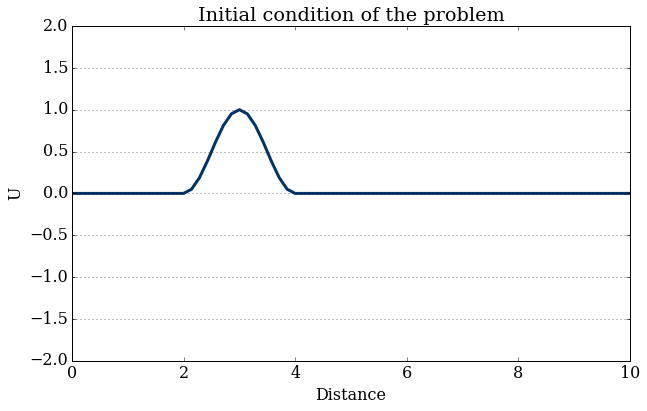

In [37]:
# Plot the initial condition
pyplot.figure(figsize=(10,6));
ax = pyplot.axes(xlim=(0,10),ylim=(-2,2),xlabel=('Distance'),ylabel=('U'));
ax.set_yticks([-2.0, -1.5, -1.0, -0.5, 0.0, 0.5, 1.0, 1.5, 2.0], minor=True)
ax.yaxis.grid(True, which='minor')
pyplot.title('Initial condition of the problem');
pyplot.plot(x, u0, color='#003366', ls='-', lw=3)
pyplot.ylim(-2,2);

The initial condition of the problem is described by the pulse shown in the above figure. Now let's advect the pulse using the following two upwind schemes:
1. A first-order finite difference scheme.
2. A second-order Padé scheme.

The time integration is done using a two-stage Runge-Kutta (RK2) scheme.

In [38]:
time = Tstart;

unew = numpy.copy(u0)
usr  = numpy.copy(u0)

# Using RK2 time, backward space (1st Order in space and 2nd order in time)
uFD  = numpy.copy(u0)
uFDP = numpy.zeros((Ntime,nx))

# Using RK2 time, backward space (2nd Order Pade in space and 2nd order in time)
uCFD  = numpy.copy(u0)
dudx = numpy.zeros_like(u0)
uCFDP = numpy.zeros((Ntime,nx))

#Exact solution at end of simulation time
uend = numpy.zeros_like(u0)

for iter in range (Ntime): 
    #Finite difference
    #-----------------
    #Stage 1
    usr[1:] = uFD[1:] - 0.5*dt*c*(uFD[1:]-uFD[:-1])/dx
        
    #Impose BC
    usr[0] = usr[-1]
    #-------
    
    #Stage 2
    unew[1:] = uFD[1:] - dt*c*(usr[1:]-usr[:-1])/dx
        
    #Impose BC
    unew[0] = unew[-1]
    #-------
    
    # Copy values to old array
    uFD = numpy.copy(unew)
    uFDP[iter][:] = numpy.copy(unew)
    
    
    #Compact finite difference
    #-------------------------
    # Stage 1
    # Compute spatial derivatives
    dudx[0] = dudx[nx-1]  #Periodic BC
    dudx[1:] = 2/dx*(uCFD[1:]-uCFD[:-1]) - dudx[:-1]
    usr[1:] = uCFD[1:] - 0.5*dt*c*dudx[1:]
    
    #Impose BC
    usr[0] = usr[-1]
    #-------
    
    # Stage 2
    # Compute spatial derivatives
    dudx[0] = dudx[nx-1]  #Periodic BC
    dudx[1:] = 2/dx*(usr[1:]-usr[:-1]) - dudx[:-1]         
    unew[1:] = uCFD[1:] - dt*c*dudx[1:]  
    
    #Impose BC
    unew[0] = unew[-1]
    #-------
    
    # Copy values to old array
    uCFD = numpy.copy(unew)
    uCFDP[iter][:] = numpy.copy(unew)
    
    
    time = time + dt;
    
print('Amplitude error in Finite Difference: {:.2f}'.format(100*(1.0-max(uFD))),'%');
print('Amplitude error in Compact Finite Difference: {:.2f}'.format(100*(1.0-max(uCFD))),'%');

Amplitude error in Finite Difference: 68.09 %
Amplitude error in Compact Finite Difference: 15.13 %



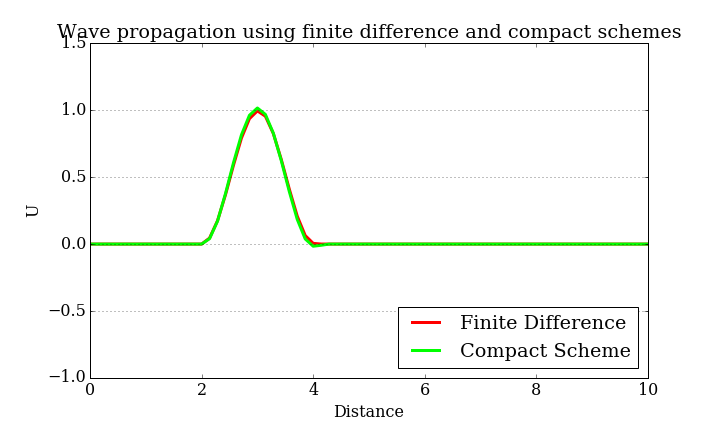
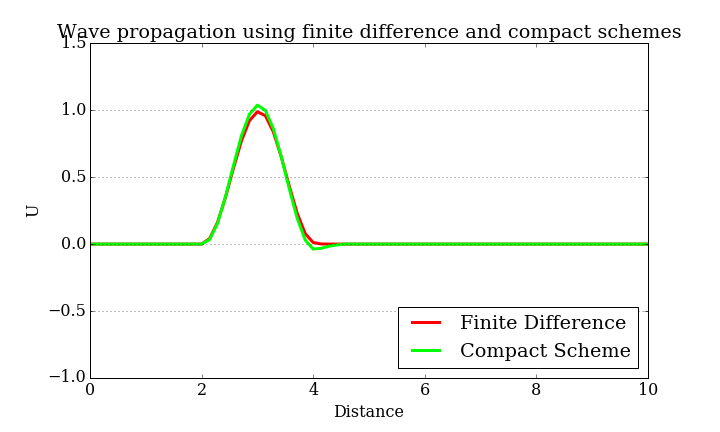
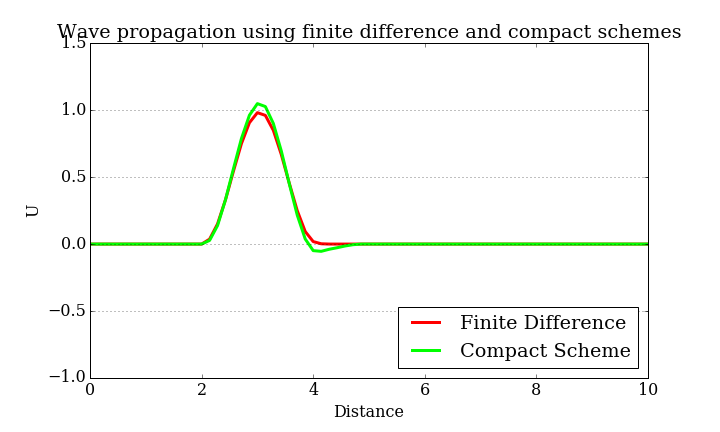
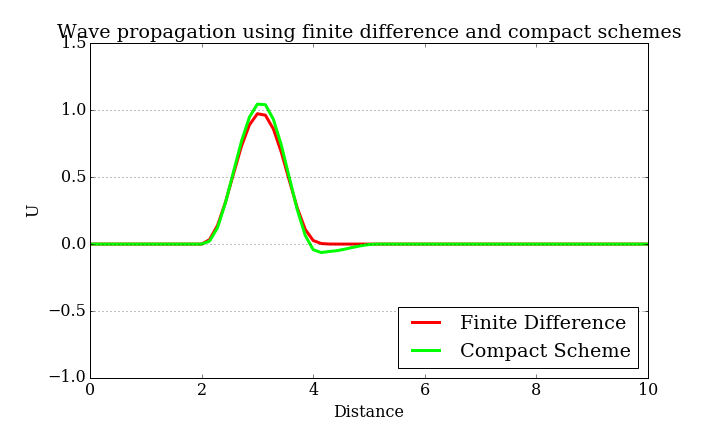
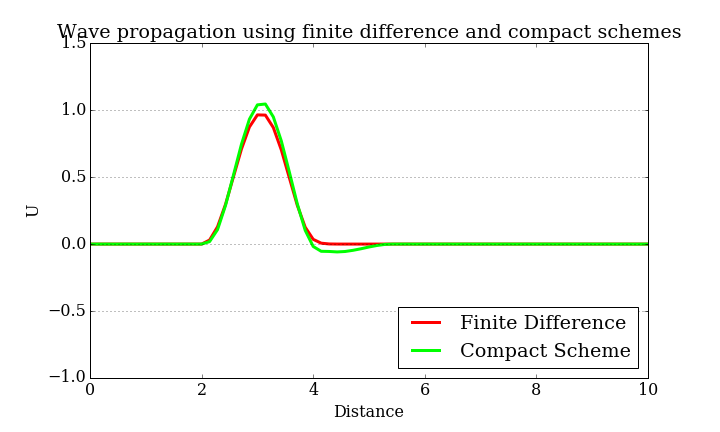
...
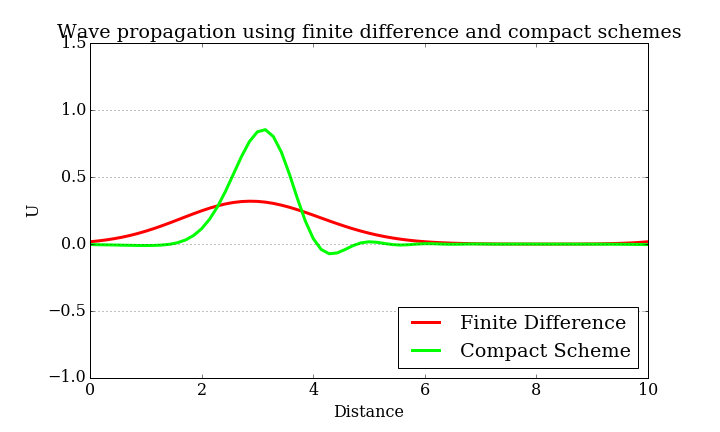
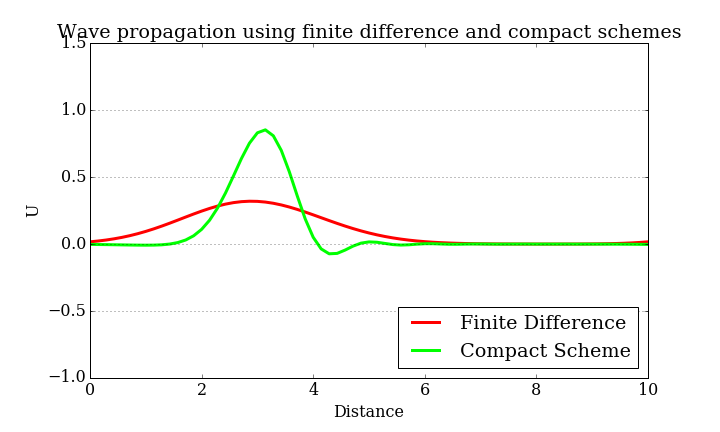
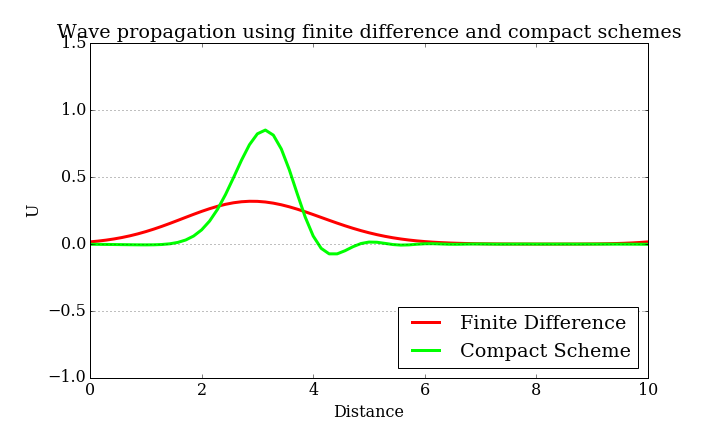
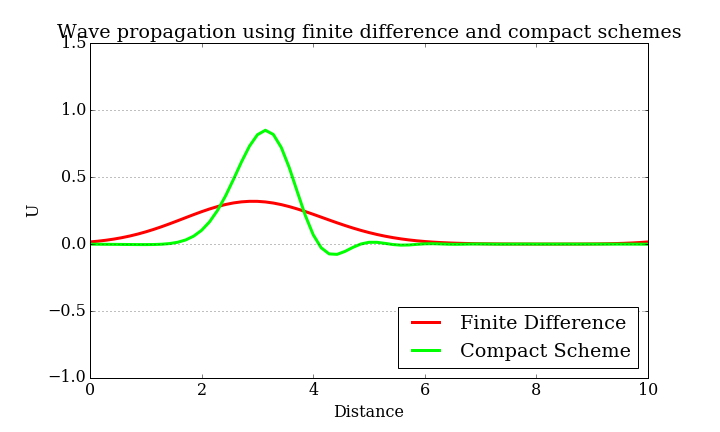
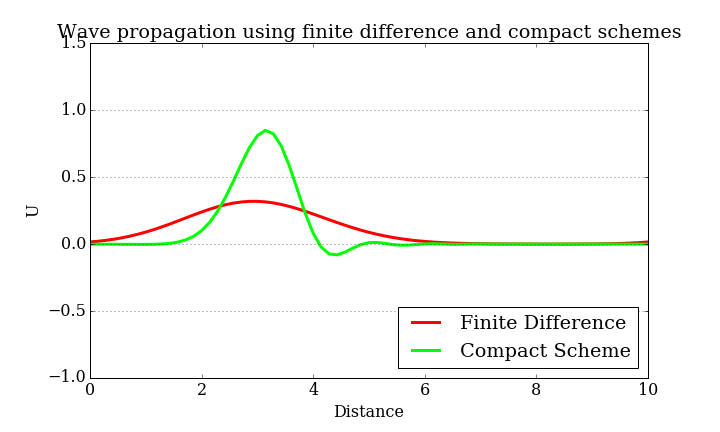

In [39]:
#This may take a while to buffer!
data = numpy.zeros((Ntime, 2), dtype=numpy.ndarray)
for i in range(Ntime):
    data[i,0] = uFDP[i,:]
    data[i,1] = uCFDP[i,:]

def animate(data):
    x = numpy.linspace(0, 10, nx)
    y1 = data[0]
    y2 = data[1]
    line1.set_data(x,y1)
    line2.set_data(x,y2)
    return line1, line2, 

fig = pyplot.figure(figsize=(10,6))
ax = pyplot.axes(xlim=(0,10),ylim=(-1,1.5),xlabel=('Distance'),ylabel=('U'))
ax.set_yticks([ -1.0, -0.5, 0.0, 0.5, 1.0, 1.5], minor=True)
ax.yaxis.grid(True, which='minor')

line1, = ax.plot([],[],color='#ff0000', lw=3, label='Finite Difference')
line2, = ax.plot([],[],color='#00ff00', lw=3, label='Compact Scheme')
pyplot.title('Wave propagation using finite difference and compact schemes')
ax.legend(loc = 'lower right')

anim = animation.FuncAnimation(fig, animate, frames=data, interval=20)
display_animation(anim, default_mode='once')

We see that the finite difference approximation of the wave starts diffusing almost immediately and by the time it has traveled one period, it dissipated to nearly $30\%$ of its original amplitude. The wavelength of the pulse increased from $2.0$ at $t = 0.0$ to almost $6.0$ at $t = 5.0$, a $200\%$ increase.

By constrast, the compact scheme preserved the pulse amplitude as well as its thickness to a significantly greater degree. At $t = 5.0$, the amplitude of the wave decreased to about $85\%$ of the initial amplitude and pulse thickness increased by nearly $50\%$. 

Although the compact scheme was better able to preserve the wave amplitude and thickness, it introduced spurious oscillations ahead of the shock, in the form of an initial whip. This whip is fed back into the traveling wave due to the periodic boundary condition, resulting in a small phase difference in the approximated pulse. The feedback of the oscillations can be eliminated if the wave is convected out of the domain (try it!). The oscillations could be explained by Godunov's $\href{https://en.wikipedia.org/wiki/Godunov's_theorem} {theorem}$ as a second-order scheme was implemented. Artificial damping can be introduced to suppress the oscillations, if needed. This, however, will also increase dissipation of the wave amplitude and has, therefore, been excluded from the present analysis.

The present simulation was carried out at a low $CFL$ $( \approx 0.1)$. As the $CFL$ is increased, the amplitude of oscillations increases, indicating greater error and the solution becomes unstable for $CFL \gt 0.5$, indicating that the stability requirement on the compact scheme is more stringent. Using the finite-difference scheme, on the other hand, does not result in greater amplitude dissipation at larger values of $CFL$. Thus, the finite-difference scheme permits marching the solution considerably faster. However, the amplitude errors introduced by numerical dissipation are large enough to offset this advantage.

Since the wave travels the length of the domain exactly once after $t = 5.0$, the analytic solution of the wave at $t = 5.0$ will match the initial condition. Thus, we can compare the results from the two approximations with the initial condition.

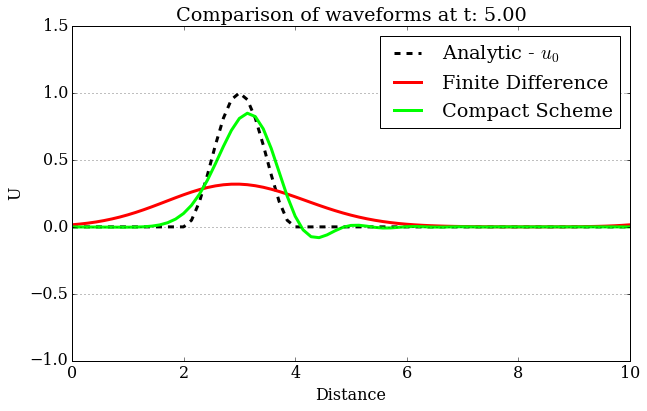

In [40]:
pyplot.figure(figsize=(10,6))
ax = pyplot.axes(xlim=(0,10),ylim=(-1,1.5),xlabel=('Distance'),ylabel=('U'))
ax.set_yticks([ -1.0, -0.5, 0.0, 0.5, 1.0, 1.5], minor=True)
ax.yaxis.grid(True, which='minor')
pyplot.title('Comparison of waveforms at t: {:.2f}'.format(time))
pyplot.plot(x, u0, color='#000000', ls='--', lw=3, label='Analytic - $u_{0}$')
pyplot.plot(x, uFD, color='#ff0000', ls='-', lw=3, label='Finite Difference')
pyplot.plot(x, uCFD, color='#00ff00', ls='-', lw=3, label='Compact Scheme')
pyplot.legend();

## _Advantages and Disadvantages of Compact Schemes_

Compact schemes provide at least twice the order of accuracy as the corresponding finite difference scheme using the same stencil. This helps provide better approximations to convective and diffusive phenomena as shown in the preceeding sections. They are also capable of better resolution for smaller scales of turbulence [<font color="ff0000">4</font>]. 

These schemes are not, however, without their share of difficulties. Since spatial derivatives are computed implicitly, a linear system of equations must be solved. The number of equations to be solved increases as $(N_{g})^{n_{dim}}$, where $N_{g}$ is the number of grid points along any axis and $n_{dim} (= 1, 2, 3)$ is the number of dimensions. Compact schemes can be trivially and manually constructed for uniform grid spacing in all directions. However for non-uniform grid spacing, particularly with larger stencils, the linear system may not be solved easily. Further, the system requires boundary conditions on the derivatives, which may not be available from the problem, and might be needed to be artificially created. Further, in this report, all problems were defined with either Dirichlet or periodic boundary conditions. Implementing Neumann boundary conditions may not be trivial and poor treatment may result in conamination of global accuracy.

The upwind compact schemes are more sensitive to the values of $CFL$ number, indicating more stringent stability constraints for explicit formulation. However, simulating hyperbolic problems at low $CFL$ may be justified by the fact that traditional finite-difference schemes are overly dissipative, irrespective of the $CFL$. Further, compact schemes may not provide a good representation of non-smooth functions and result in large spurious oscillations upstream of the wave. This can be tested by starting with a step function, instead of a sinusoidal pulse (initial condition is provided, try it!). This drawback may introduce greater challenges in modeling flows with sharp discontinuities (flows with shocks or multiphase flows).

## _References_

1. Zang TA, Streett CL, Hussaini MY (1989). "*Spectral Methods for CFD*". Institute for Computer Applications in Science NASA Langley Research Center, Report No. 89-13, Hampton, Virginia 23665.

2. Karnidakis GE, Sherwin S (2005). "*Spectral/hp Element Methods for CFD*". Oxford University Press, ISBN: 0 19 852869 8 9780198528692.

3. Kampanis NA, Dougalis VA, Ekaterinaris JA (2007). "*Effective Computational Methods for Wave Propagation*". Chapman & Hall/ CRC, ISBN: 13:978-1-58488-568-9.

4. Lele SK (1992). "*Compact Finite Difference Schemes with Spectral-like Resolution*". Journal of Computational Physics 103, pp: 16-42.

In [26]:
from IPython.core.display import HTML
css_file = './style.css'
HTML(open(css_file, "r").read())